In [1]:
import pandas as pd
import pandas_profiling # a feature for lazy
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
sns.set_style("whitegrid")

In [59]:
# !pip install pandas-profiling

In [34]:
def featuresTypes(var_info):
    NUMERICAL = []
    CATEGORICAL = []
    for var in var_info:
        if var_info[var]['type'] == 'Numeric':
            NUMERICAL += [var]
        elif var_info[var]['type'] == 'Categorical':
            CATEGORICAL += [var]
    
    return(NUMERICAL, CATEGORICAL)
            
# if TARGET in NUMERICAL:
#     NUMERICAL.remove(TARGET)
# elif TARGET in CATEGORICAL:
#     CATEGORICAL.remove(TARGET)


def boxplots(NUMERICAL, data):
    for f in NUMERICAL:
        plt.figure(figsize=(15, 3))
        sns.boxplot(data=data[f], orient='h').set_title(f)
        plt.show()

        
def boxplots_target(NUMERICAL, data, target):
    for f in NUMERICAL:
        plt.figure(figsize=(15, 3))
        sns.boxplot(x=f, y=target, hue=target, data=data, orient='h')
        plt.show()

        
def histplots(data, NUMERICAL):
    cols = 3
    rows = 9

    num_cols = data.select_dtypes(exclude='object').columns
    fig = plt.figure( figsize=(cols*5, rows*5))
    for i, col in enumerate(NUMERICAL):
    
        ax=fig.add_subplot(rows,cols,i+1)
    
        sns.histplot(x = data[col], ax = ax)
    
    fig.tight_layout()  
    plt.show()

    
def violinplots(data, NUMERICAL):
    for f in NUMERICAL:
        plt.figure(figsize=(15, 3))
        sns.violinplot(x=data[f], orient='h').set_title(f)
        plt.show()


def stripplots(data, NUMERICAL):
    for f in NUMERICAL:
        plt.figure(figsize=(15, 3))
        sns.stripplot(x=data[f], orient='h').set_title(f)
        plt.show()
        

def outliers_rem(col, data, value):
    if col in ["WeightInit", "Prothrombin time", "Bilirubin total", "Creatinine", "AST", "ALT", "WBC- Leukocytes"]:
        data.loc[data[col] > value, col] = np.nan
    elif col == "Height":
        data.loc[data[col] < value, col] = np.nan    

### Data

In [4]:
data = pd.read_csv("dataset_result.csv", index_col=0)
data

,Name,WeightInit,Height,DateDiff,WeightDiff,Target,TargetWeight,StartEpizode,ObesityDegree,Age,...,Bilirubin total,Creatinine,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit
0,GACAAKt,100.0,176.0,32,0.0,0,100.0,2013-05-20,1.0,64.156164,...,8.90,112.0,7.40,5.60,5.00,36.0,51.0,3.90,140.0,41.70
1,GACAAXQ,100.0,172.5,358,0.0,0,100.0,2018-01-23,1.0,66.958904,...,7.00,123.0,3.10,9.30,5.70,21.0,37.0,8.20,155.0,43.40
2,GACAAZy,86.0,162.0,307,0.0,0,86.0,2009-09-04,1.0,63.602740,...,7.75,97.5,3.35,7.70,4.95,20.0,27.5,7.35,140.5,41.25
3,GACAAil,83.0,163.0,162,-3.0,-1,80.0,2013-03-21,1.0,73.065753,...,8.50,72.0,3.60,6.10,4.20,19.0,18.0,6.50,126.0,39.10
4,GACABVe,90.0,164.0,219,-1.0,-1,89.0,2009-09-16,1.0,73.452055,...,12.90,62.0,4.40,6.10,4.30,14.0,11.0,5.70,130.0,36.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,GACBAНg,100.0,168.0,317,2.0,1,102.0,2017-06-20,2.0,43.616438,...,9.30,60.0,3.70,5.70,4.70,17.0,17.0,8.80,136.8,43.70
561,GACBAХH,98.0,174.0,233,-6.0,-1,92.0,2019-04-24,1.0,61.063014,...,11.50,66.0,4.70,4.95,4.55,18.5,21.0,10.00,149.0,44.50
562,GACBAкЪ,116.0,182.0,326,-14.0,-1,102.0,2019-11-22,1.0,16.342466,...,13.70,72.0,5.70,4.20,4.40,20.0,25.0,7.60,146.0,42.10
563,GACBAэы,130.0,189.0,142,4.0,1,134.0,2020-11-16,2.0,23.298630,...,13.70,78.0,3.70,4.60,4.00,23.0,42.0,12.60,155.0,44.40


In [5]:
TARGET = "TargetWeight"
TARGET_1 = "Target" # потеря веса, вес не изменился, набор веса

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 565 entries, 0 to 564
Data columns (total 23 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Name                              565 non-null    object 
 1   WeightInit                        565 non-null    float64
 2   Height                            565 non-null    float64
 3   DateDiff                          565 non-null    int64  
 4   WeightDiff                        565 non-null    float64
 5   Target                            565 non-null    int64  
 6   TargetWeight                      565 non-null    float64
 7   StartEpizode                      565 non-null    object 
 8   ObesityDegree                     565 non-null    float64
 9   Age                               565 non-null    float64
 10  Gender                            565 non-null    int64  
 11  Prothrombin time                  565 non-null    float64
 12  Prothrom

In [7]:
# Извлечем только необходимые столбцы
data = data[["Name", "WeightInit", "Height", "DateDiff", "ObesityDegree", "Age", "Gender", 
            "Prothrombin time", "Prothrombin (according to Quick)", "Bilirubin total",
            "Creatinine", "Total cholesterol", "Glucose (syv.)", "Potassium", "AST",
            "ALT", "WBC- Leukocytes", "HGB- Hemoglobin", "HCT-Hematocrit", "Target", "TargetWeight"]]

In [8]:
data

,Name,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Prothrombin (according to Quick),Bilirubin total,...,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
0,GACAAKt,100.0,176.0,32,1.0,64.156164,-1,12.7,97.0,8.90,...,7.40,5.60,5.00,36.0,51.0,3.90,140.0,41.70,0,100.0
1,GACAAXQ,100.0,172.5,358,1.0,66.958904,-1,21.2,45.0,7.00,...,3.10,9.30,5.70,21.0,37.0,8.20,155.0,43.40,0,100.0
2,GACAAZy,86.0,162.0,307,1.0,63.602740,1,16.5,84.5,7.75,...,3.35,7.70,4.95,20.0,27.5,7.35,140.5,41.25,0,86.0
3,GACAAil,83.0,163.0,162,1.0,73.065753,1,11.8,124.0,8.50,...,3.60,6.10,4.20,19.0,18.0,6.50,126.0,39.10,-1,80.0
4,GACABVe,90.0,164.0,219,1.0,73.452055,1,13.5,986.0,12.90,...,4.40,6.10,4.30,14.0,11.0,5.70,130.0,36.50,-1,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,GACBAНg,100.0,168.0,317,2.0,43.616438,1,13.7,91.0,9.30,...,3.70,5.70,4.70,17.0,17.0,8.80,136.8,43.70,1,102.0
561,GACBAХH,98.0,174.0,233,1.0,61.063014,1,13.7,91.0,11.50,...,4.70,4.95,4.55,18.5,21.0,10.00,149.0,44.50,-1,92.0
562,GACBAкЪ,116.0,182.0,326,1.0,16.342466,-1,13.7,91.0,13.70,...,5.70,4.20,4.40,20.0,25.0,7.60,146.0,42.10,-1,102.0
563,GACBAэы,130.0,189.0,142,2.0,23.298630,-1,13.7,91.0,13.70,...,3.70,4.60,4.00,23.0,42.0,12.60,155.0,44.40,1,134.0


## Univariate Analysis

In [9]:
data.describe()

,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Prothrombin (according to Quick),Bilirubin total,Creatinine,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
count,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000,565.000000
mean,98.876106,167.938496,168.286726,1.443363,53.040732,0.313274,15.050531,130.105310,13.877168,102.888496,5.111770,6.081593,4.348850,22.745044,26.400000,8.070177,136.235221,40.084159,0.127434,98.665487
std,31.419810,10.322948,102.710548,0.673968,16.010553,0.950504,5.940548,161.040745,7.197304,108.213437,1.154615,1.548237,0.432392,9.300110,13.630339,2.673296,15.645509,4.952148,0.853471,18.238169
min,69.000000,101.000000,30.000000,1.000000,11.717808,-1.000000,11.300000,12.000000,2.600000,44.000000,1.200000,3.800000,2.000000,7.000000,6.000000,2.800000,100.000000,24.900000,-1.000000,65.000000
25%,86.000000,161.000000,79.000000,1.000000,40.860274,-1.000000,12.800000,85.000000,9.600000,68.000000,4.300000,5.200000,4.100000,17.000000,17.000000,6.300000,126.000000,37.000000,-1.000000,88.000000
50%,95.000000,168.000000,143.000000,1.000000,56.178082,1.000000,13.300000,96.000000,12.433333,76.000000,5.000000,5.666667,4.300000,20.300000,24.000000,7.550000,136.000000,40.100000,0.000000,96.000000
75%,105.000000,175.000000,253.000000,2.000000,64.975342,1.000000,14.300000,104.833333,16.200000,93.000000,5.885714,6.400000,4.600000,25.000000,32.000000,9.200000,147.000000,43.800000,1.000000,106.000000
max,735.000000,204.000000,364.000000,3.000000,88.547945,1.000000,89.200000,996.000000,86.700000,946.000000,10.800000,18.900000,7.000000,86.000000,98.800000,27.100000,180.000000,53.100000,1.000000,289.000000


##### Prothrombin time
A prothrombin time test (PT) measures the time it takes for a clot to form in a blood sample.

norm 10-13.5 sec

##### Bilirubin total 
Билирубин общий – это сумма промежуточных продуктов метаболизма гемоглобина, содержащихся в сыворотке крови: непрямого и прямого билирубина

Незначительное повышение – 85 ммоль/л, тяжёлые формы патологии значения поднимаются до 170 ммоль/л и более.

norm 0-21 мкмоль/л

##### Creatinine 
A creatinine test is a measure of how well your kidneys are performing their job of filtering waste from your blood.

norm :
- For adult men, 0.74 to 1.35 mg/dL (65.4 to 119.3 micromoles/L)
- For adult women, 0.59 to 1.04 mg/dL (52.2 to 91.9 micromoles/L)
- общие от 0 недель: 45-105 мкмоль/л
- общие от 1 недель: 35-62 мкмоль/л
- общие от 1 лет: 45-105 мкмоль/л
- мужчины от 15 лет: 74-110 мкмоль/л
- мужчины от 50 лет: 72-127 мкмоль/л
- женщины от 15 лет: 58-96 мкмоль/л

##### Total cholesterol
Total cholesterol – the overall amount of cholesterol in your blood, including both "good" and "bad" cholesterol

Healthy level (mmol/L) 5 or below

##### Potassium
Potassium is a chemical that is critical to the function of nerve and muscle cells, including those in your heart.

normally 3.6 to 5.2 millimoles per liter (mmol/L)

##### AST
Аспартатаминотрансфераза (АСТ) — это фермент, который в основном содержится в клетках печени и сердечной мышцы. При повреждении этих органов он в избытке попадает в кровоток

мужчины – до 40 Ед/л;
женщины – до 32 Ед/л;
беременные – до 35 Ед/л.

##### ALT
Аланинаминотрансфераза обеспечивает превращение одних аминокислот в другие. Вещество активно синтезируется клетками печени.

Старше 17	(Мужчины) Менее 41	(Женщины) Менее 31
Беременные	—	Менее 33

##### WBC- Leukocytes
White blood cells, also called leukocytes or leucocytes, are the cells of the immune system that are involved in protecting the body against both infectious disease and foreign invaders.

A healthy adult human has between 4,500 and 11,000

##### HGB- Hemoglobin
A high hemoglobin count indicates an above-normal level of the iron-containing protein in red blood cells. Hemoglobin (often abbreviated as Hb or Hgb) is the oxygen-carrying component of red blood cells.

Норма для мужчин 130-160г/л, для женщин – 120-140г/л

##### HCT-Hematocrit
The hematocrit measures the volume of red blood cells compared to the total blood volume (red blood cells and plasma). 

The normal hematocrit for men is 40 to 54%; for women it is 36 to 48%

In [10]:
profile_report = pandas_profiling.ProfileReport(data, progress_bar=False)
profile_report.to_notebook_iframe()

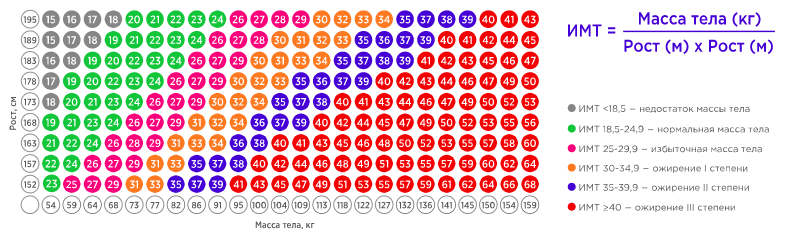

In [11]:
tmp_df = data[data["ObesityDegree"]==1.5]
tmp_df

,Name,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Prothrombin (according to Quick),Bilirubin total,...,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
208,GACAQHщ,97.0,171.0,218,1.5,17.353425,-1,12.75,101.000000,12.9,...,4.600000,5.0,4.4,21.0,18.0,4.8,144.0,41.9,-1,96.0
210,GACAQJP,113.0,181.5,72,1.5,15.975342,-1,12.25,111.000000,17.8,...,3.800000,5.3,4.1,17.0,17.0,5.5,142.0,42.2,1,116.0
298,GACAUv9,91.0,176.0,102,1.5,66.649315,1,30.60,25.000000,11.2,...,5.233333,5.2,4.6,9.0,9.0,11.7,123.0,37.7,1,92.0
455,GACA]uE,87.0,167.0,194,1.5,14.578082,1,12.15,119.000000,12.0,...,4.000000,4.8,4.3,18.0,14.0,6.9,113.0,34.2,-1,85.0
476,GACAa+Л,84.0,165.5,98,1.5,11.717808,-1,15.92,73.066667,13.3,...,4.300000,5.4,4.6,28.0,22.0,9.0,148.0,41.9,1,87.0


[208] - 2 

[210] - 2

[298] - 1

[455] - 1

[476] - 1

In [12]:
data["ObesityDegree"][208] = 2
data["ObesityDegree"][210] = 2
data["ObesityDegree"][298] = 1
data["ObesityDegree"][455] = 1
data["ObesityDegree"][476] = 1

/tmp/ipykernel_66326/2728885142.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["ObesityDegree"][208] = 2
/tmp/ipykernel_66326/2728885142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["ObesityDegree"][210] = 2
/tmp/ipykernel_66326/2728885142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["ObesityDegree"][298] = 1
/tmp/ipykernel_66326/2728885142.py:4: SettingWithCopyWarning: 
A value is trying to be set on 

In [13]:
rej_vars = profile_report.get_rejected_variables()
rej_vars

set()

In [14]:
var_info = profile_report.get_description()['variables'] # metadata from report

In [15]:
NUMERICAL, CATEGORICAL = featuresTypes(var_info)
        
print('Num. of numeric variables: {}'.format(len(NUMERICAL)))
print('Num. of categorical variables: {}'.format(len(CATEGORICAL)))

Num. of numeric variables: 17
Num. of categorical variables: 4


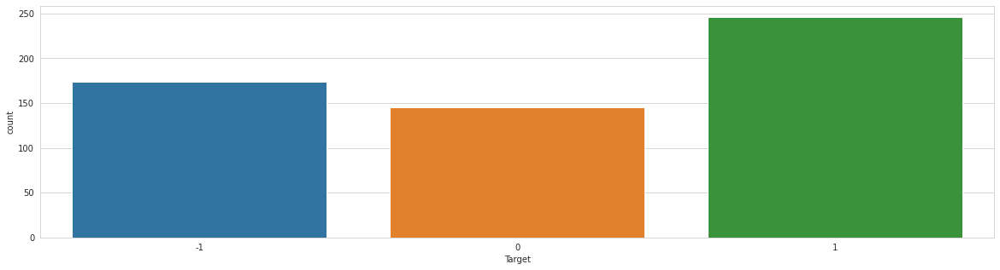

In [16]:
plt.figure(figsize=(20, 5))
sns.countplot(x=TARGET_1, data=data)
plt.show()

Классы сбалансированы 

Убрали 1.5

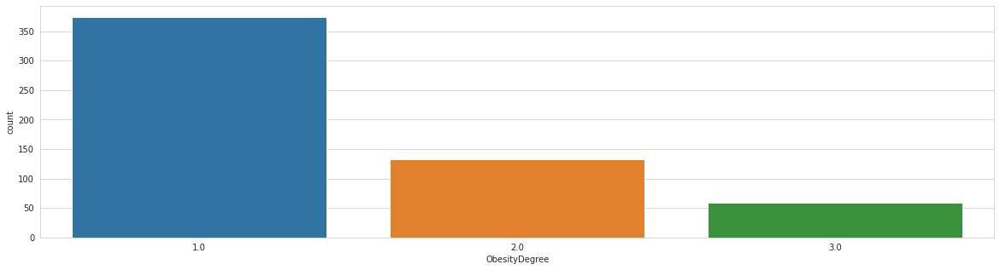

In [17]:
plt.figure(figsize=(20, 5))
sns.countplot(x="ObesityDegree", data=data)
plt.show()

### Numeric Features

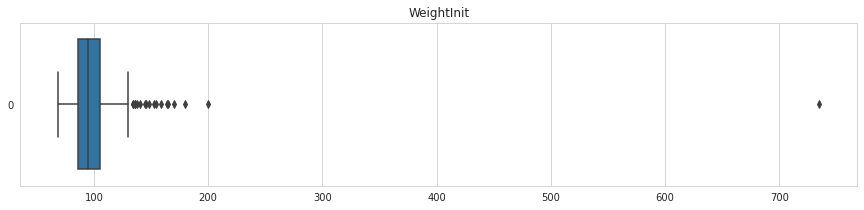

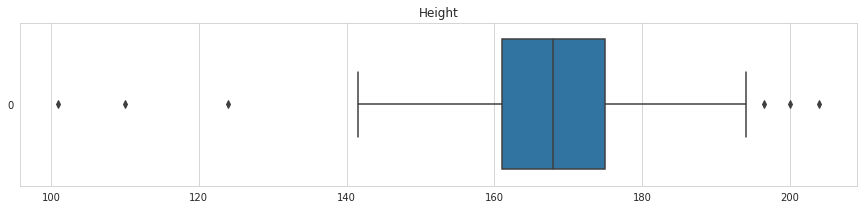

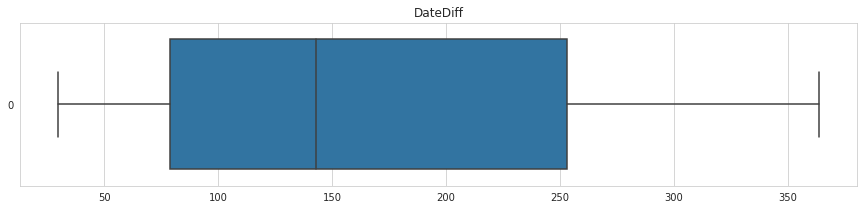

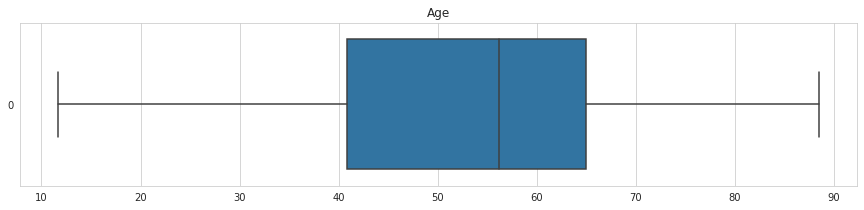

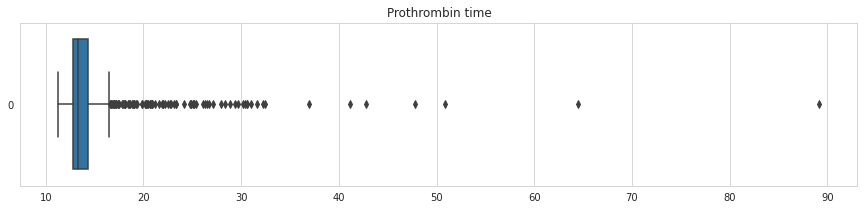

...

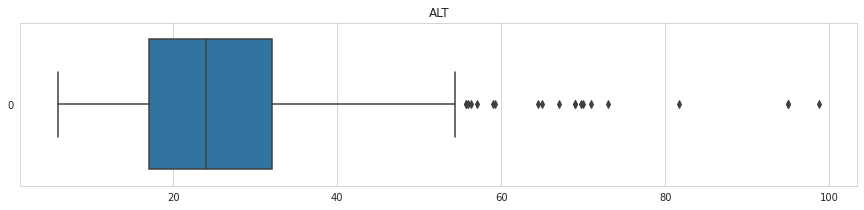

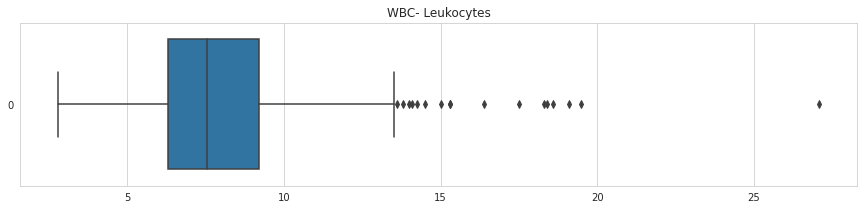

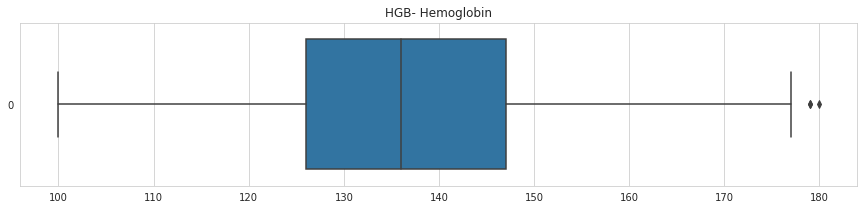

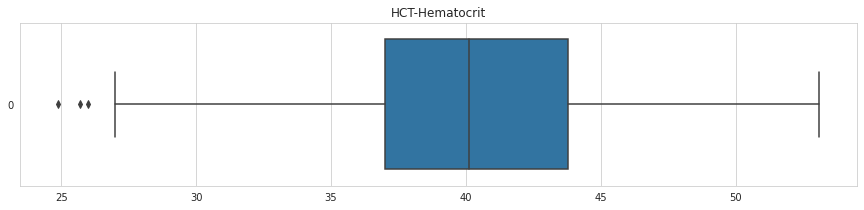

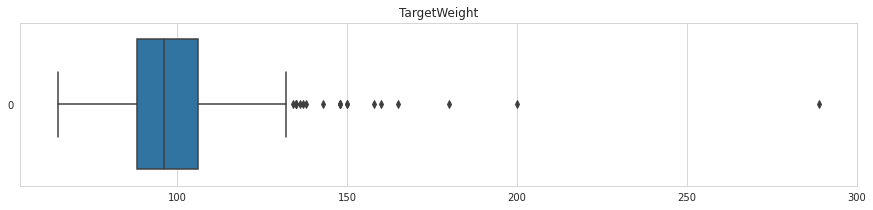

In [20]:
boxplots(NUMERICAL, data)

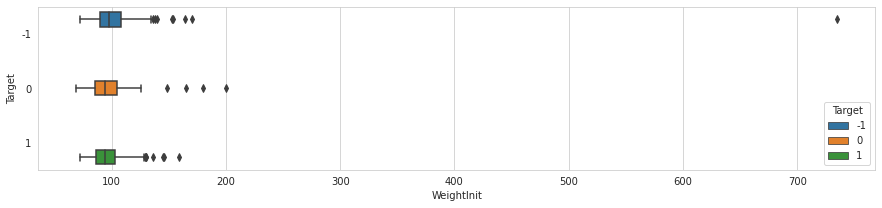

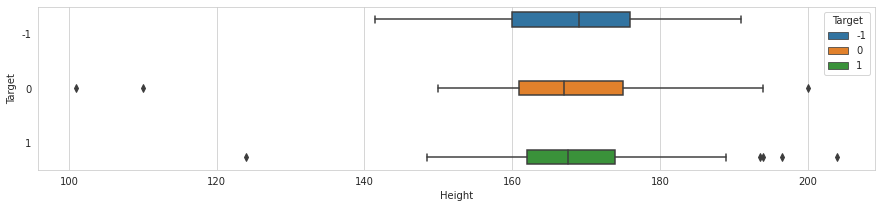

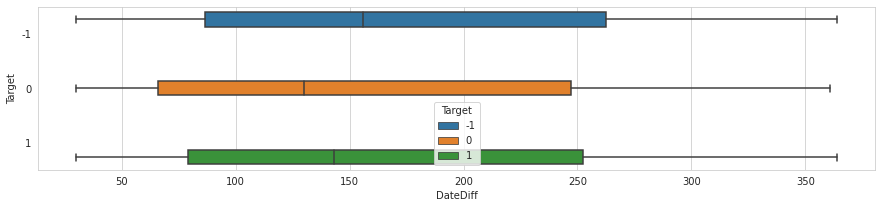

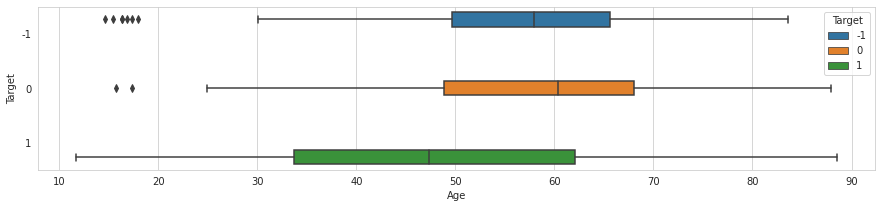

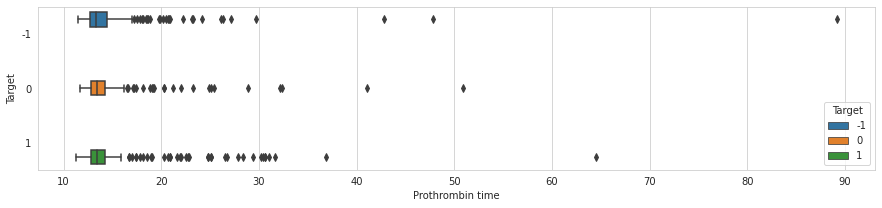

...

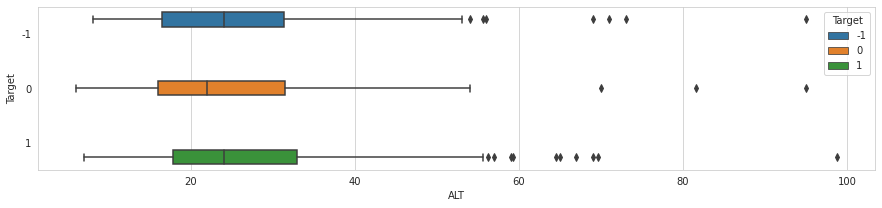

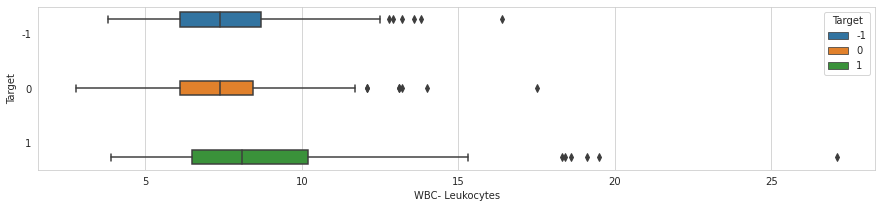

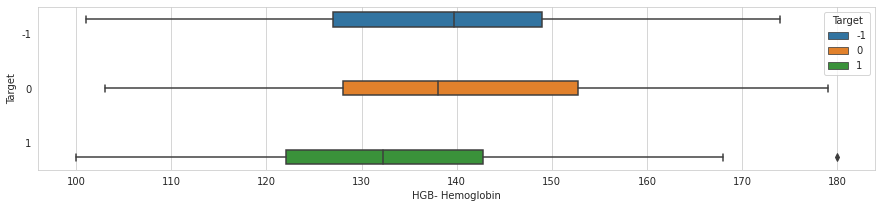

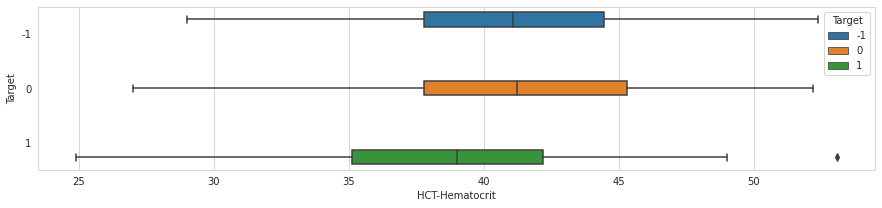

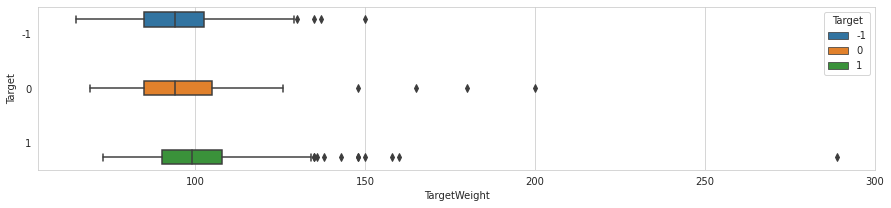

In [22]:
boxplots_target(NUMERICAL, data, TARGET_1)

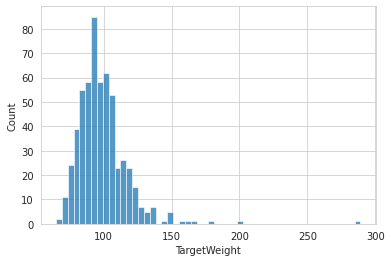

In [23]:
# histogram for target
sns.histplot(x=TARGET, data=data);

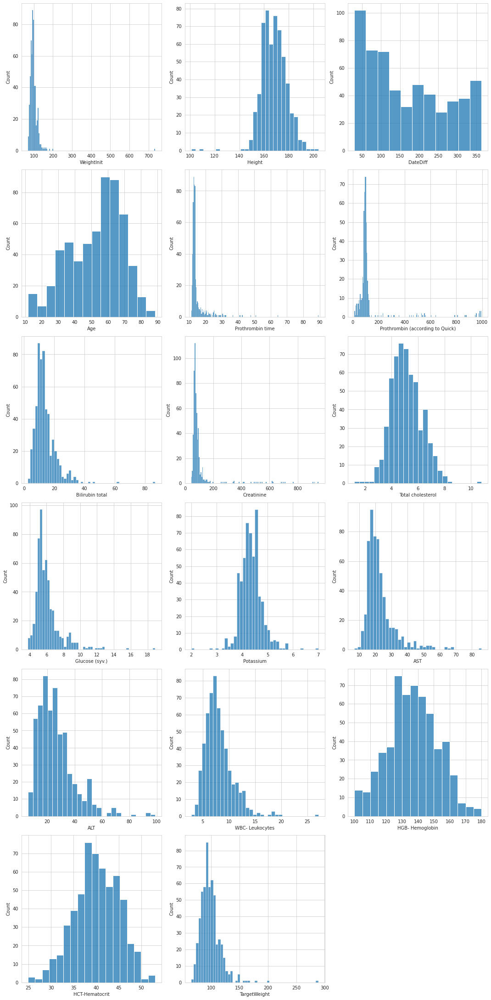

In [25]:
histplots(data, NUMERICAL)

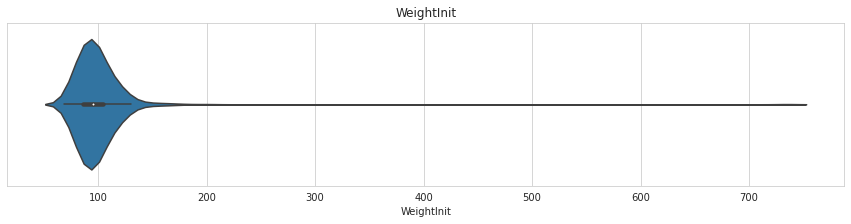

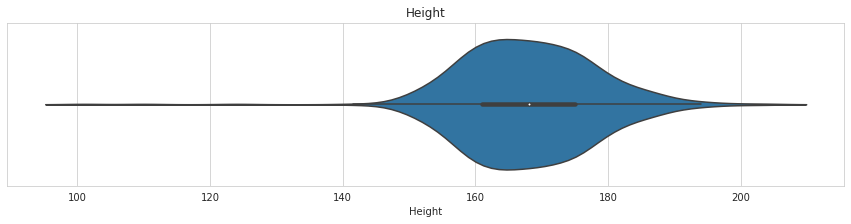

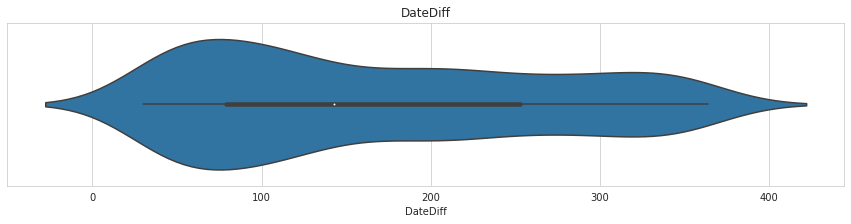

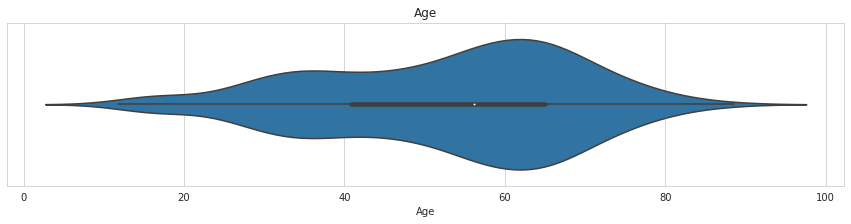

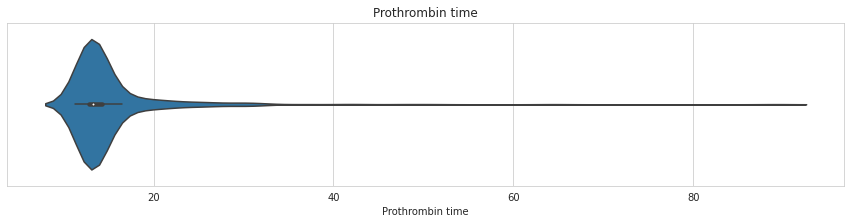

...

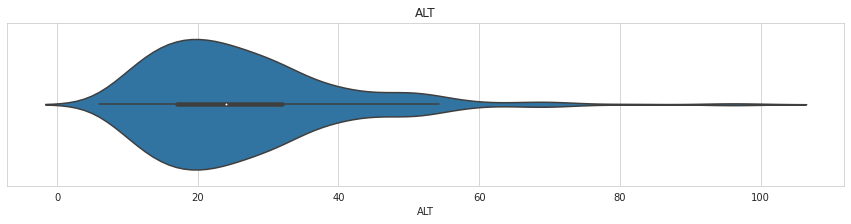

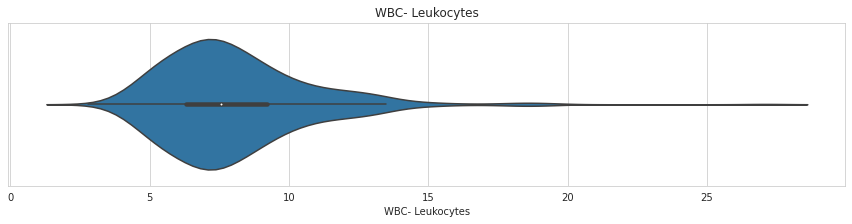

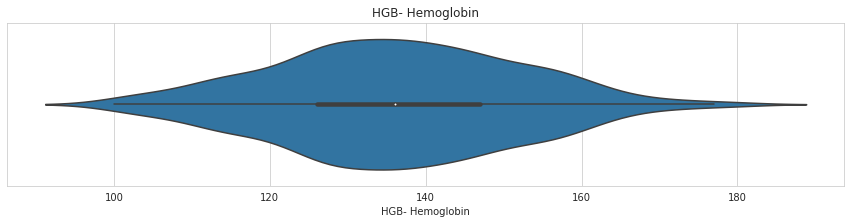

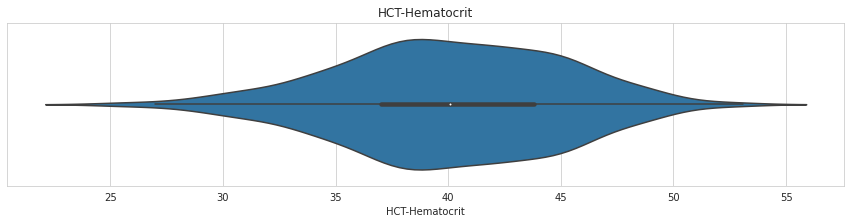

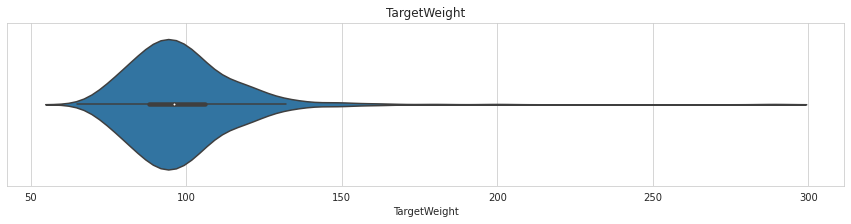

In [27]:
violinplots(data, NUMERICAL)

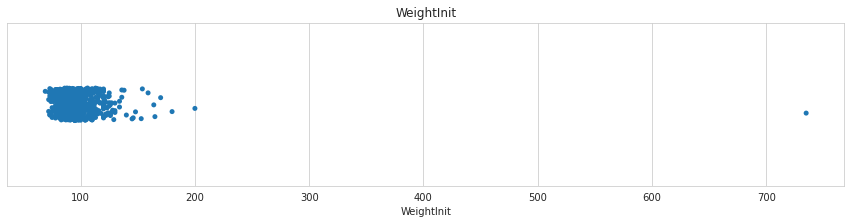

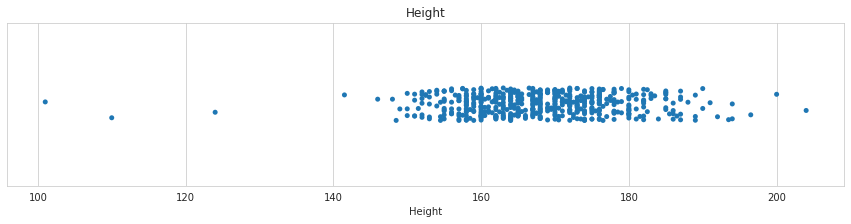

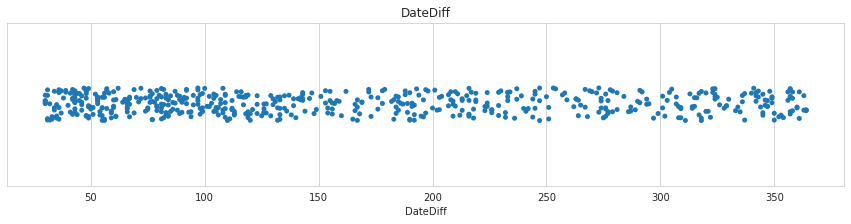

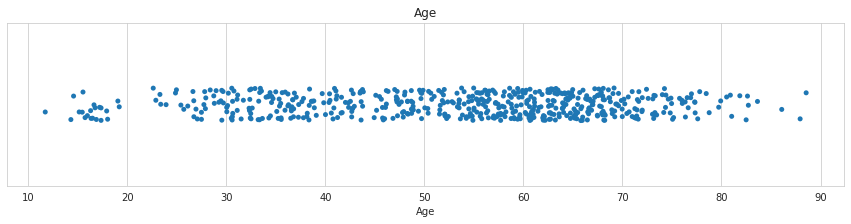

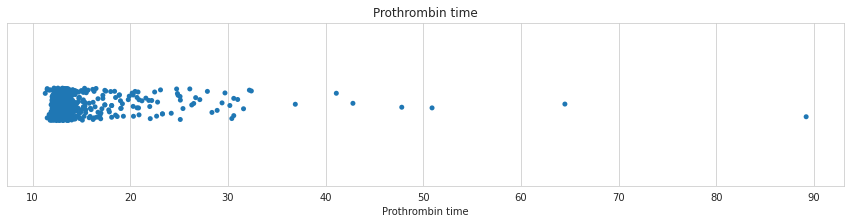

...

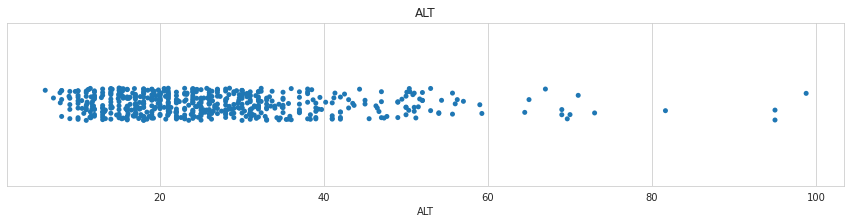

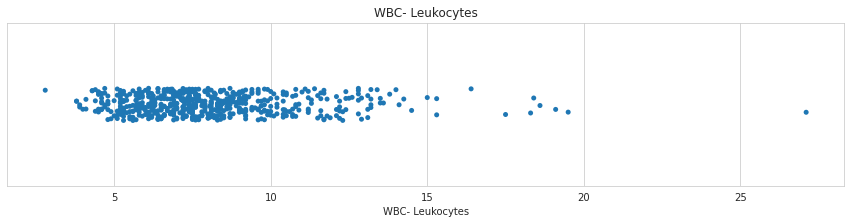

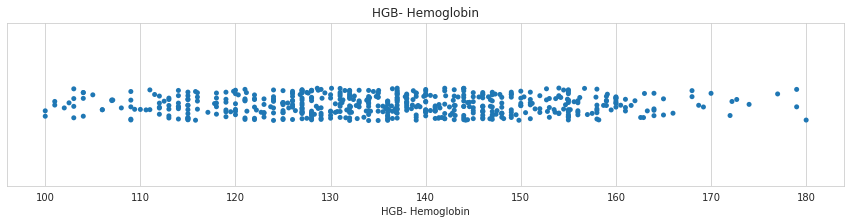

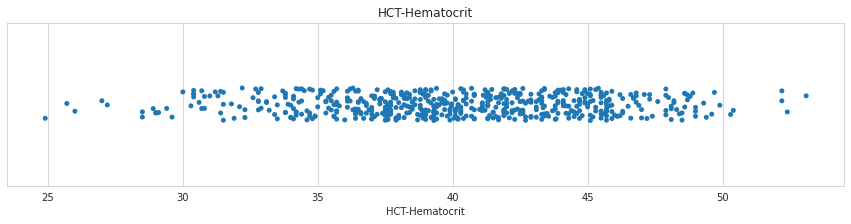

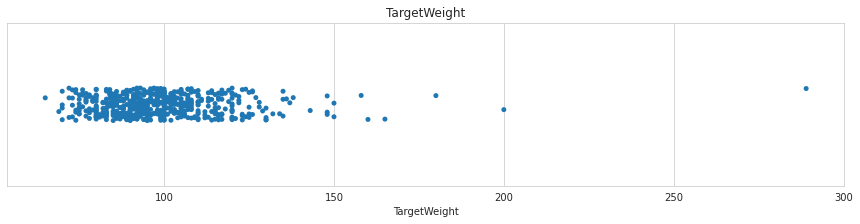

In [29]:
stripplots(data, NUMERICAL)

### Categorical Features

In [72]:
data[CATEGORICAL].nunique()

Name             565
ObesityDegree      3
Gender             2
Target             3
dtype: int64

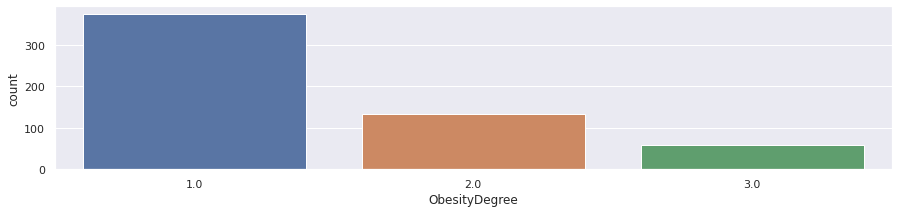

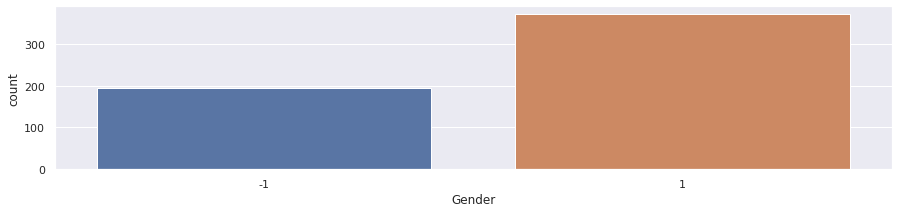

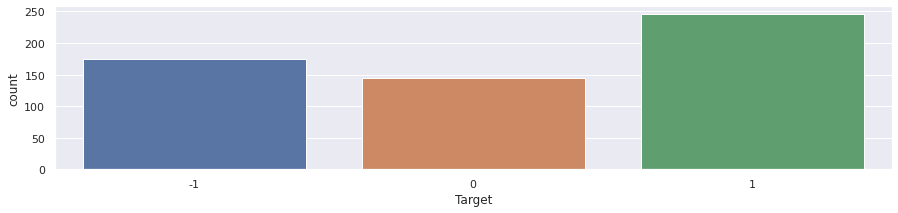

In [116]:
for f in CATEGORICAL:
    if f == "Name":
        continue
    plt.figure(figsize=(15, 3))
    sns.countplot(x=f, data=data)
    plt.show();

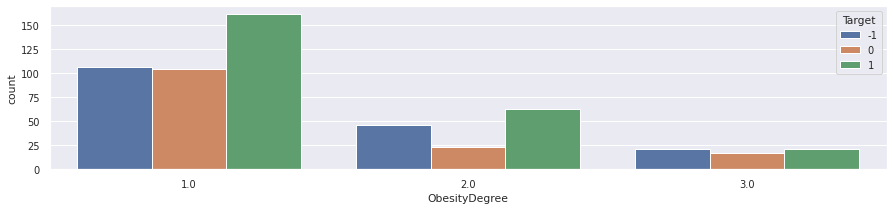

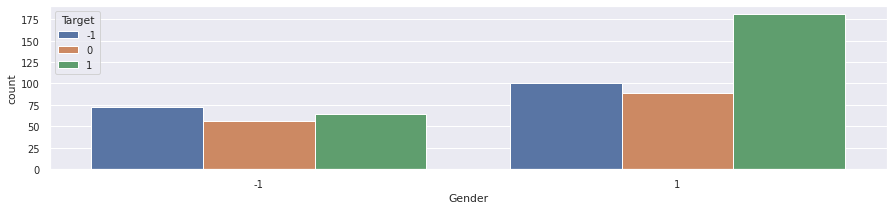

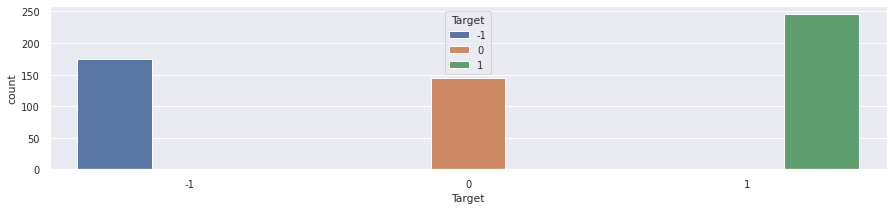

In [85]:
for f in CATEGORICAL:
    if f == "Name":
        continue
    plt.figure(figsize=(15, 3))
    sns.countplot(x=f, hue=TARGET_1, data=data)
    plt.show();

### Outliers removing

Outliers:
- WeightInit (>250)
- Prothrombin time (>40)
- Ptothrombin (according to Quick) (delete, высокая корреляция с Prothrombin time)
- Bilirubin total (>60)
- Creatinine (>800)
- AST (>80)
- ALT (>80)
- Leukocytes (>20)
- Height (<140)

Заменить величины на NaN

In [30]:
data

,Name,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Prothrombin (according to Quick),Bilirubin total,...,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
0,GACAAKt,100.0,176.0,32,1.0,64.156164,-1,12.7,97.0,8.90,...,7.40,5.60,5.00,36.0,51.0,3.90,140.0,41.70,0,100.0
1,GACAAXQ,100.0,172.5,358,1.0,66.958904,-1,21.2,45.0,7.00,...,3.10,9.30,5.70,21.0,37.0,8.20,155.0,43.40,0,100.0
2,GACAAZy,86.0,162.0,307,1.0,63.602740,1,16.5,84.5,7.75,...,3.35,7.70,4.95,20.0,27.5,7.35,140.5,41.25,0,86.0
3,GACAAil,83.0,163.0,162,1.0,73.065753,1,11.8,124.0,8.50,...,3.60,6.10,4.20,19.0,18.0,6.50,126.0,39.10,-1,80.0
4,GACABVe,90.0,164.0,219,1.0,73.452055,1,13.5,986.0,12.90,...,4.40,6.10,4.30,14.0,11.0,5.70,130.0,36.50,-1,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,GACBAНg,100.0,168.0,317,2.0,43.616438,1,13.7,91.0,9.30,...,3.70,5.70,4.70,17.0,17.0,8.80,136.8,43.70,1,102.0
561,GACBAХH,98.0,174.0,233,1.0,61.063014,1,13.7,91.0,11.50,...,4.70,4.95,4.55,18.5,21.0,10.00,149.0,44.50,-1,92.0
562,GACBAкЪ,116.0,182.0,326,1.0,16.342466,-1,13.7,91.0,13.70,...,5.70,4.20,4.40,20.0,25.0,7.60,146.0,42.10,-1,102.0
563,GACBAэы,130.0,189.0,142,2.0,23.298630,-1,13.7,91.0,13.70,...,3.70,4.60,4.00,23.0,42.0,12.60,155.0,44.40,1,134.0


In [31]:
# удалим столбец Ptothrombin (according to Quick) (delete, высокая корреляция с Prothrombin time)
data = data.drop('Prothrombin (according to Quick)', axis=1)
data

,Name,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Bilirubin total,Creatinine,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
0,GACAAKt,100.0,176.0,32,1.0,64.156164,-1,12.7,8.90,112.0,7.40,5.60,5.00,36.0,51.0,3.90,140.0,41.70,0,100.0
1,GACAAXQ,100.0,172.5,358,1.0,66.958904,-1,21.2,7.00,123.0,3.10,9.30,5.70,21.0,37.0,8.20,155.0,43.40,0,100.0
2,GACAAZy,86.0,162.0,307,1.0,63.602740,1,16.5,7.75,97.5,3.35,7.70,4.95,20.0,27.5,7.35,140.5,41.25,0,86.0
3,GACAAil,83.0,163.0,162,1.0,73.065753,1,11.8,8.50,72.0,3.60,6.10,4.20,19.0,18.0,6.50,126.0,39.10,-1,80.0
4,GACABVe,90.0,164.0,219,1.0,73.452055,1,13.5,12.90,62.0,4.40,6.10,4.30,14.0,11.0,5.70,130.0,36.50,-1,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,GACBAНg,100.0,168.0,317,2.0,43.616438,1,13.7,9.30,60.0,3.70,5.70,4.70,17.0,17.0,8.80,136.8,43.70,1,102.0
561,GACBAХH,98.0,174.0,233,1.0,61.063014,1,13.7,11.50,66.0,4.70,4.95,4.55,18.5,21.0,10.00,149.0,44.50,-1,92.0
562,GACBAкЪ,116.0,182.0,326,1.0,16.342466,-1,13.7,13.70,72.0,5.70,4.20,4.40,20.0,25.0,7.60,146.0,42.10,-1,102.0
563,GACBAэы,130.0,189.0,142,2.0,23.298630,-1,13.7,13.70,78.0,3.70,4.60,4.00,23.0,42.0,12.60,155.0,44.40,1,134.0


In [35]:
columns = ["WeightInit", "Prothrombin time", "Bilirubin total", 
           "Creatinine", "AST", "ALT", "Leukocytes", "Height"]
values = [250, 40, 60, 800, 80, 80, 20, 140]

for c, v in zip(columns, values):
    outliers_rem(c, data, v)

In [36]:
data

,Name,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Bilirubin total,Creatinine,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
0,GACAAKt,100.0,176.0,32,1.0,64.156164,-1,12.7,8.90,112.0,7.40,5.60,5.00,36.0,51.0,3.90,140.0,41.70,0,100.0
1,GACAAXQ,100.0,172.5,358,1.0,66.958904,-1,21.2,7.00,123.0,3.10,9.30,5.70,21.0,37.0,8.20,155.0,43.40,0,100.0
2,GACAAZy,86.0,162.0,307,1.0,63.602740,1,16.5,7.75,97.5,3.35,7.70,4.95,20.0,27.5,7.35,140.5,41.25,0,86.0
3,GACAAil,83.0,163.0,162,1.0,73.065753,1,11.8,8.50,72.0,3.60,6.10,4.20,19.0,18.0,6.50,126.0,39.10,-1,80.0
4,GACABVe,90.0,164.0,219,1.0,73.452055,1,13.5,12.90,62.0,4.40,6.10,4.30,14.0,11.0,5.70,130.0,36.50,-1,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,GACBAНg,100.0,168.0,317,2.0,43.616438,1,13.7,9.30,60.0,3.70,5.70,4.70,17.0,17.0,8.80,136.8,43.70,1,102.0
561,GACBAХH,98.0,174.0,233,1.0,61.063014,1,13.7,11.50,66.0,4.70,4.95,4.55,18.5,21.0,10.00,149.0,44.50,-1,92.0
562,GACBAкЪ,116.0,182.0,326,1.0,16.342466,-1,13.7,13.70,72.0,5.70,4.20,4.40,20.0,25.0,7.60,146.0,42.10,-1,102.0
563,GACBAэы,130.0,189.0,142,2.0,23.298630,-1,13.7,13.70,78.0,3.70,4.60,4.00,23.0,42.0,12.60,155.0,44.40,1,134.0


### After outliers removing

In [37]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 565 entries, 0 to 564
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Name               565 non-null    object 
 1   WeightInit         564 non-null    float64
 2   Height             562 non-null    float64
 3   DateDiff           565 non-null    int64  
 4   ObesityDegree      565 non-null    float64
 5   Age                565 non-null    float64
 6   Gender             565 non-null    int64  
 7   Prothrombin time   559 non-null    float64
 8   Bilirubin total    563 non-null    float64
 9   Creatinine         562 non-null    float64
 10  Total cholesterol  565 non-null    float64
 11  Glucose (syv.)     565 non-null    float64
 12  Potassium          565 non-null    float64
 13  AST                564 non-null    float64
 14  ALT                561 non-null    float64
 15  WBC- Leukocytes    565 non-null    float64
 16  HGB- Hemoglobin    565 non

In [38]:
data = data.interpolate()

In [39]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 565 entries, 0 to 564
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Name               565 non-null    object 
 1   WeightInit         565 non-null    float64
 2   Height             565 non-null    float64
 3   DateDiff           565 non-null    int64  
 4   ObesityDegree      565 non-null    float64
 5   Age                565 non-null    float64
 6   Gender             565 non-null    int64  
 7   Prothrombin time   565 non-null    float64
 8   Bilirubin total    565 non-null    float64
 9   Creatinine         565 non-null    float64
 10  Total cholesterol  565 non-null    float64
 11  Glucose (syv.)     565 non-null    float64
 12  Potassium          565 non-null    float64
 13  AST                565 non-null    float64
 14  ALT                565 non-null    float64
 15  WBC- Leukocytes    565 non-null    float64
 16  HGB- Hemoglobin    565 non

In [40]:
profile_report = pandas_profiling.ProfileReport(data, progress_bar=False)
var_info = profile_report.get_description()['variables'] # metadata from report

NUMERICAL, CATEGORICAL = featuresTypes(var_info)
        
print('Num. of numeric variables: {}'.format(len(NUMERICAL)))
print('Num. of categorical variables: {}'.format(len(CATEGORICAL)))

Num. of numeric variables: 16
Num. of categorical variables: 4


In [56]:
data = data[data.TargetWeight < 250]
data = data[data["Prothrombin time"] < 35]
data = data[data["Total cholesterol"] < 10]
data = data[data["Glucose (syv.)"] < 14]
data = data[data.Potassium > 3.5]
data = data[data.Potassium < 6]
data = data[data["WBC- Leukocytes"] < 25]
data = data[data["TargetWeight"] < 190]

In [57]:
data

,Name,WeightInit,Height,DateDiff,ObesityDegree,Age,Gender,Prothrombin time,Bilirubin total,Creatinine,Total cholesterol,Glucose (syv.),Potassium,AST,ALT,WBC- Leukocytes,HGB- Hemoglobin,HCT-Hematocrit,Target,TargetWeight
0,GACAAKt,100.0,176.0,32,1.0,64.156164,-1,12.7,8.90,112.0,7.40,5.60,5.00,36.0,51.0,3.90,140.0,41.70,0,100.0
1,GACAAXQ,100.0,172.5,358,1.0,66.958904,-1,21.2,7.00,123.0,3.10,9.30,5.70,21.0,37.0,8.20,155.0,43.40,0,100.0
2,GACAAZy,86.0,162.0,307,1.0,63.602740,1,16.5,7.75,97.5,3.35,7.70,4.95,20.0,27.5,7.35,140.5,41.25,0,86.0
3,GACAAil,83.0,163.0,162,1.0,73.065753,1,11.8,8.50,72.0,3.60,6.10,4.20,19.0,18.0,6.50,126.0,39.10,-1,80.0
4,GACABVe,90.0,164.0,219,1.0,73.452055,1,13.5,12.90,62.0,4.40,6.10,4.30,14.0,11.0,5.70,130.0,36.50,-1,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,GACBAНg,100.0,168.0,317,2.0,43.616438,1,13.7,9.30,60.0,3.70,5.70,4.70,17.0,17.0,8.80,136.8,43.70,1,102.0
561,GACBAХH,98.0,174.0,233,1.0,61.063014,1,13.7,11.50,66.0,4.70,4.95,4.55,18.5,21.0,10.00,149.0,44.50,-1,92.0
562,GACBAкЪ,116.0,182.0,326,1.0,16.342466,-1,13.7,13.70,72.0,5.70,4.20,4.40,20.0,25.0,7.60,146.0,42.10,-1,102.0
563,GACBAэы,130.0,189.0,142,2.0,23.298630,-1,13.7,13.70,78.0,3.70,4.60,4.00,23.0,42.0,12.60,155.0,44.40,1,134.0


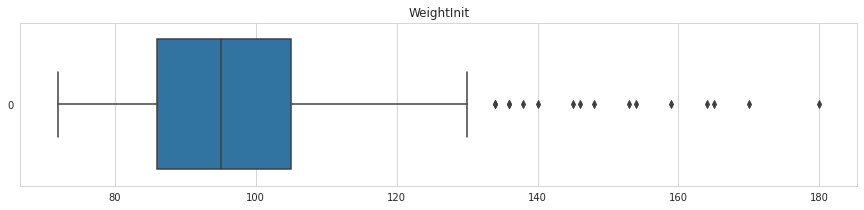

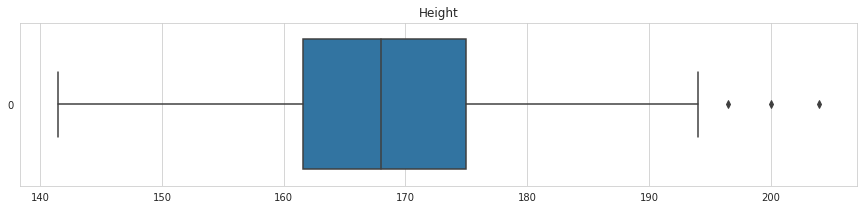

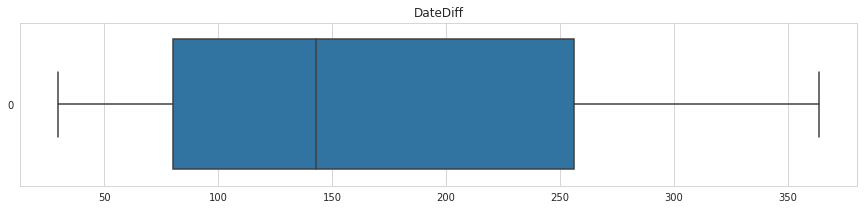

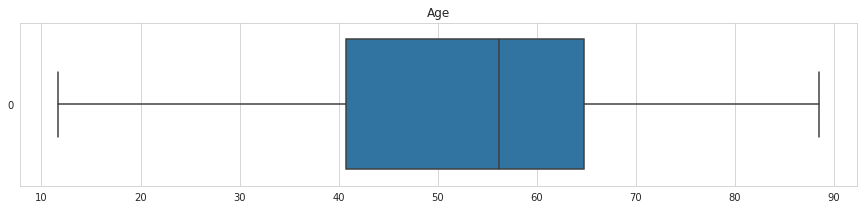

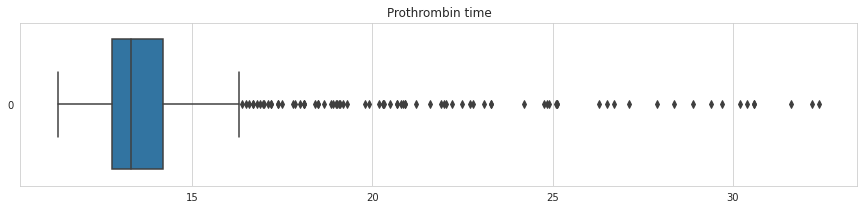

...

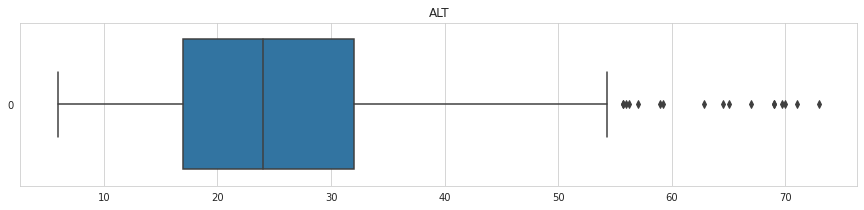

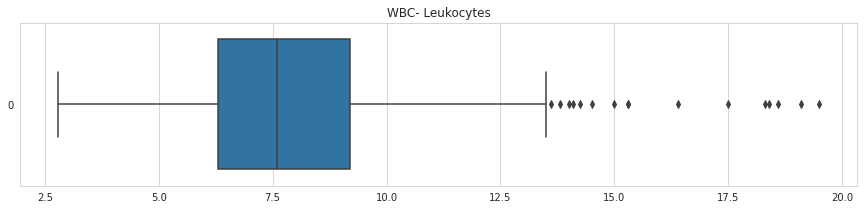

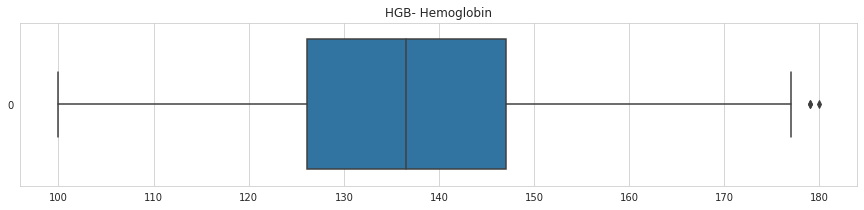

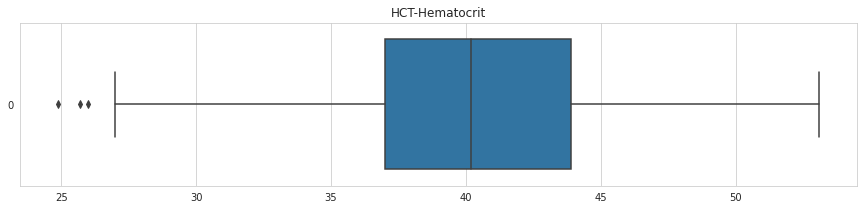

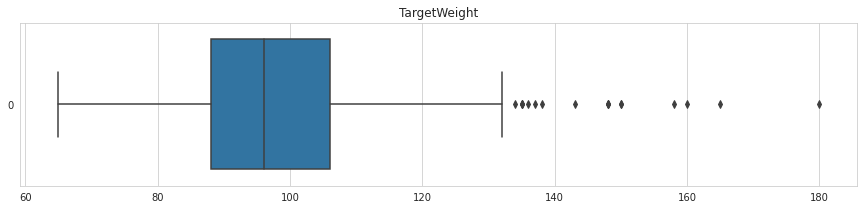

In [58]:
boxplots(NUMERICAL, data)

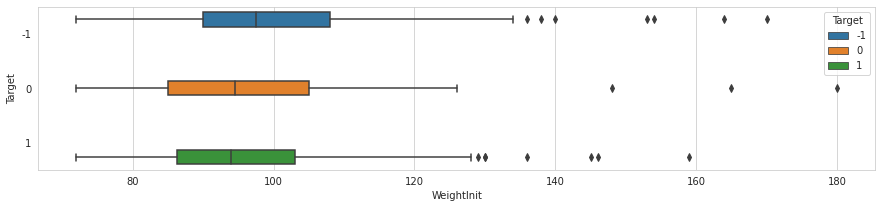

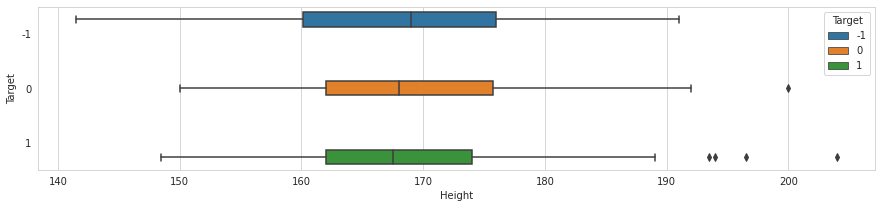

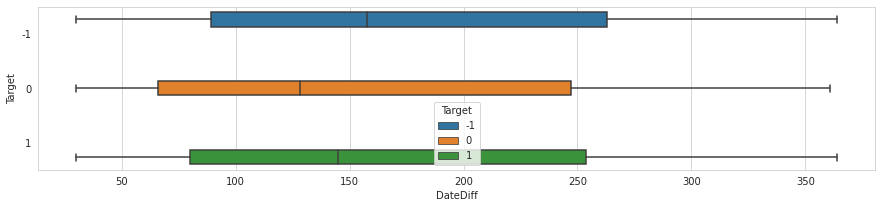

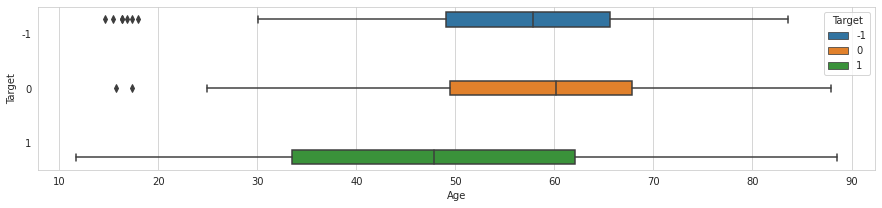

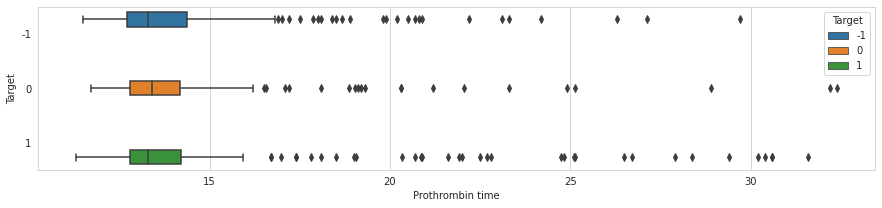

...

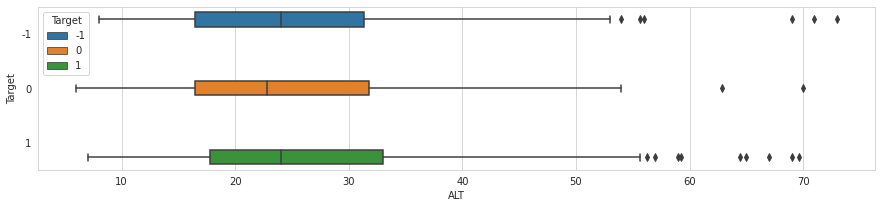

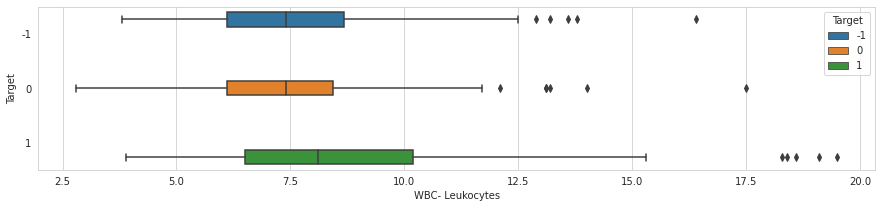

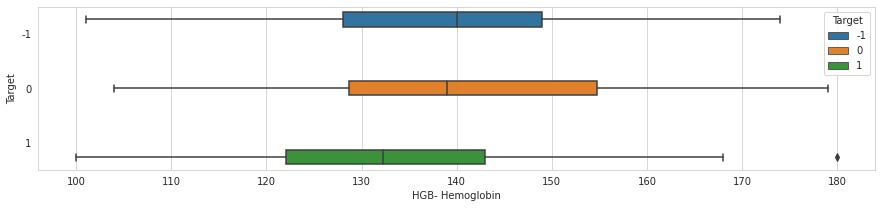

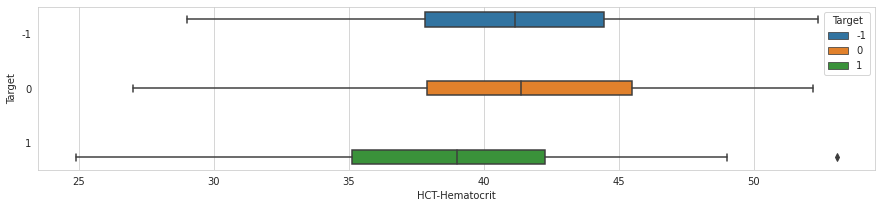

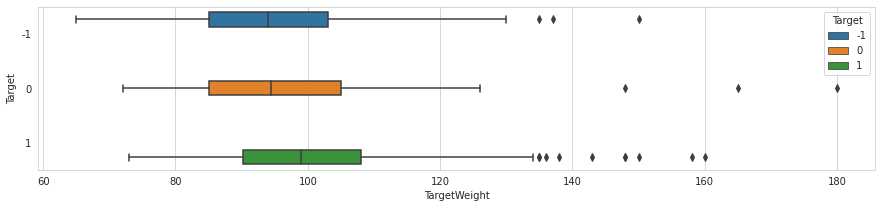

In [59]:
boxplots_target(NUMERICAL, data, TARGET_1)

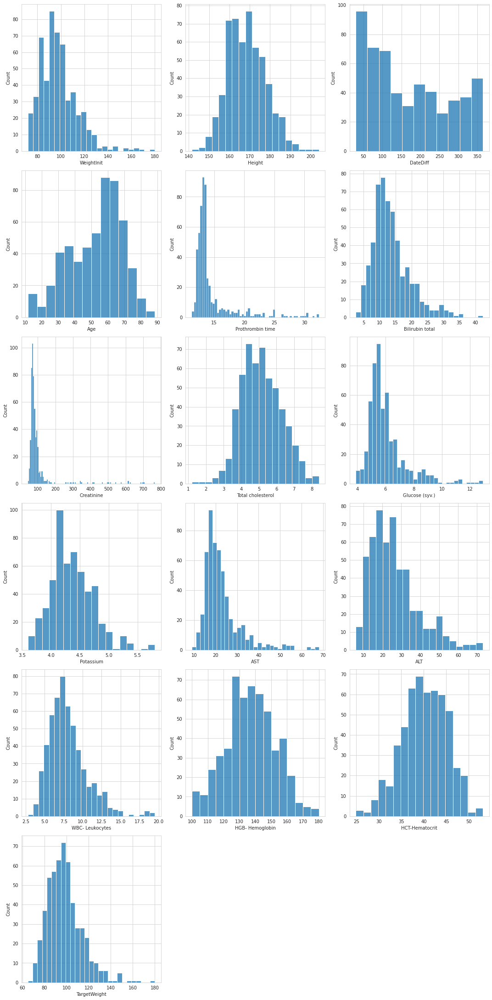

In [60]:
histplots(data, NUMERICAL)

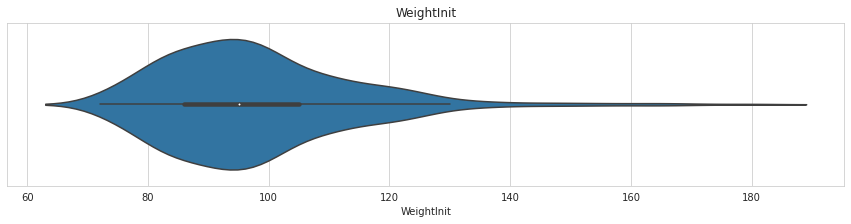

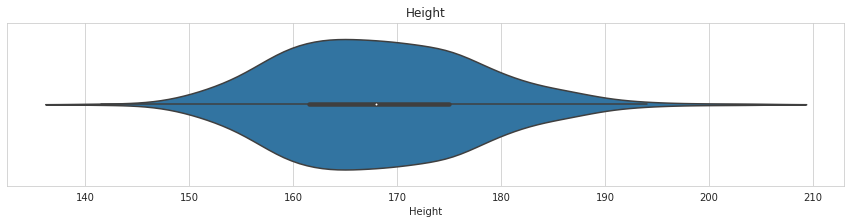

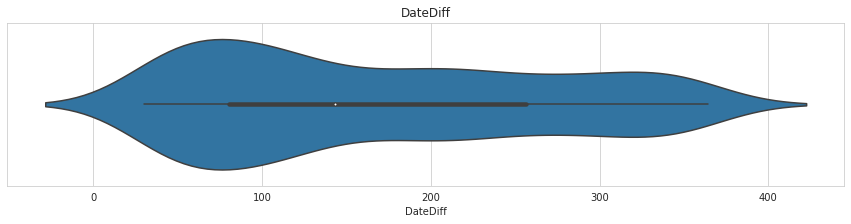

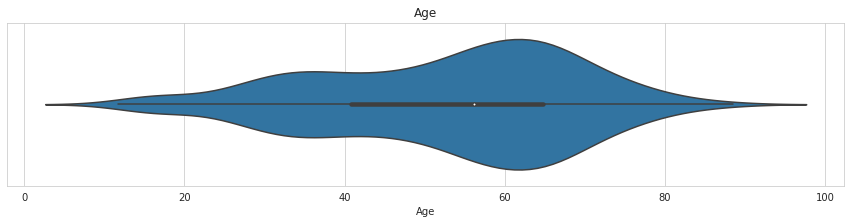

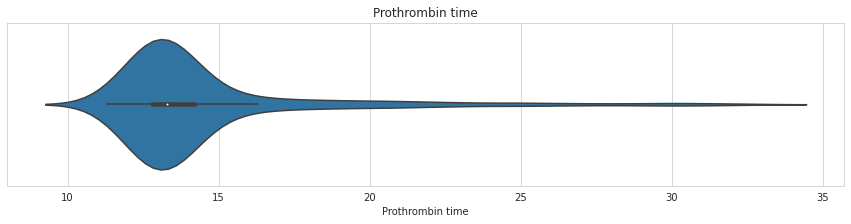

...

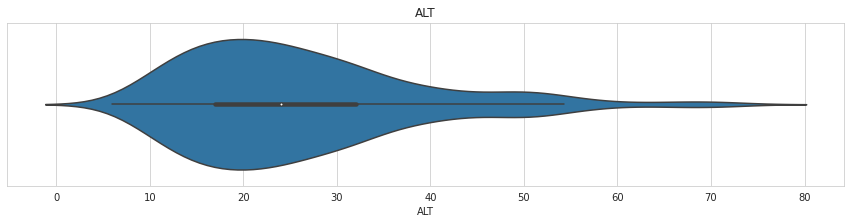

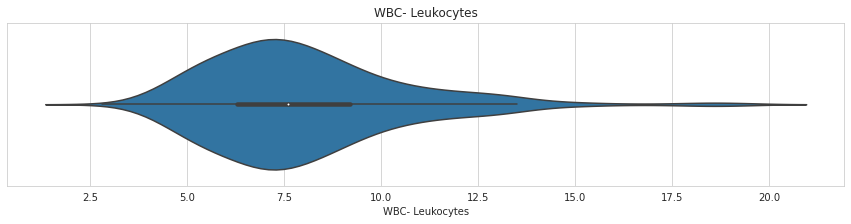

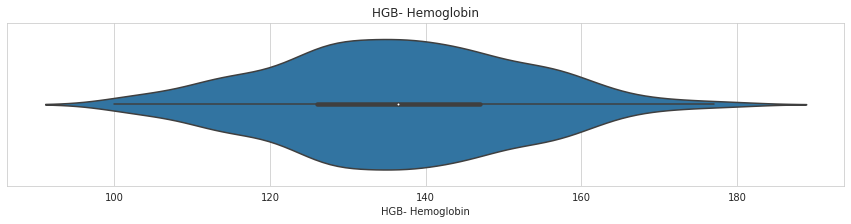

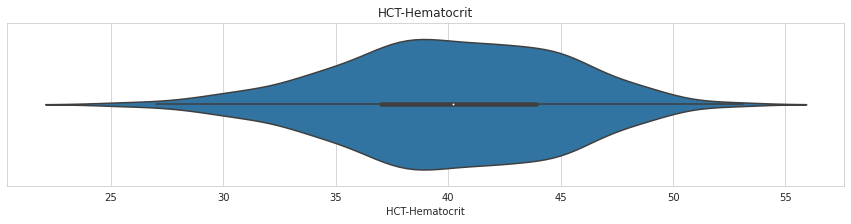

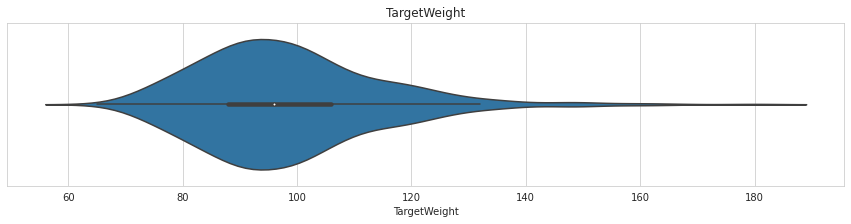

In [61]:
violinplots(data, NUMERICAL)

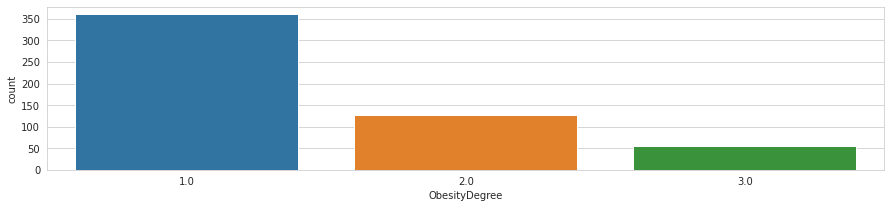

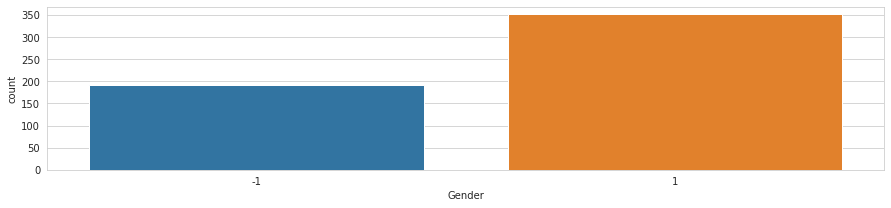

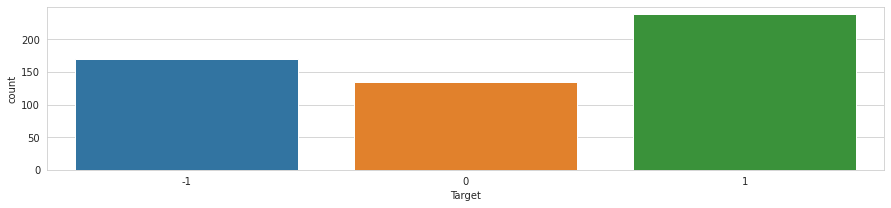

In [63]:
for f in CATEGORICAL:
    if f == "Name":
        continue
    plt.figure(figsize=(15, 3))
    sns.countplot(x=f, data=data)
    plt.show();

## Multivariate Analysis

<Figure size 7200x7200 with 0 Axes>

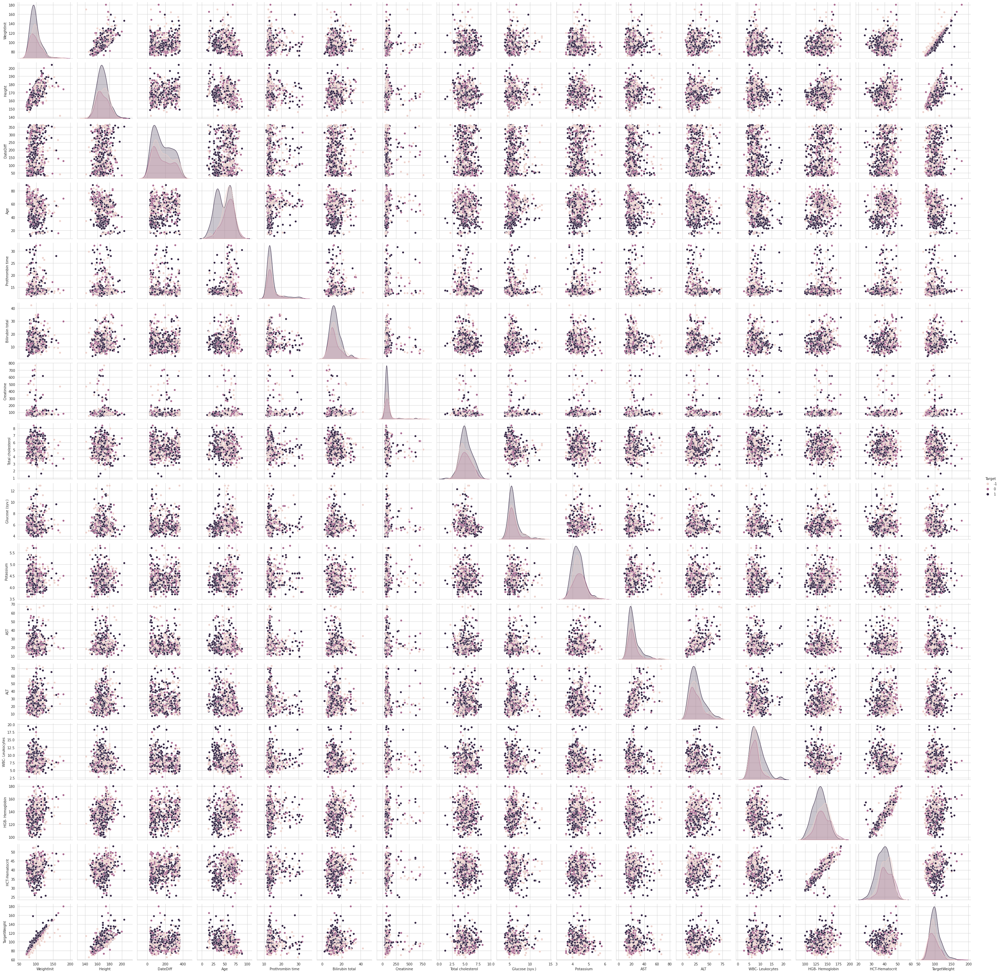

In [64]:
# sns.set(font_scale=0.9)
plt.figure(figsize=(100,100))
sns.pairplot(data=data[NUMERICAL + [TARGET_1]], hue=TARGET_1)
plt.show();

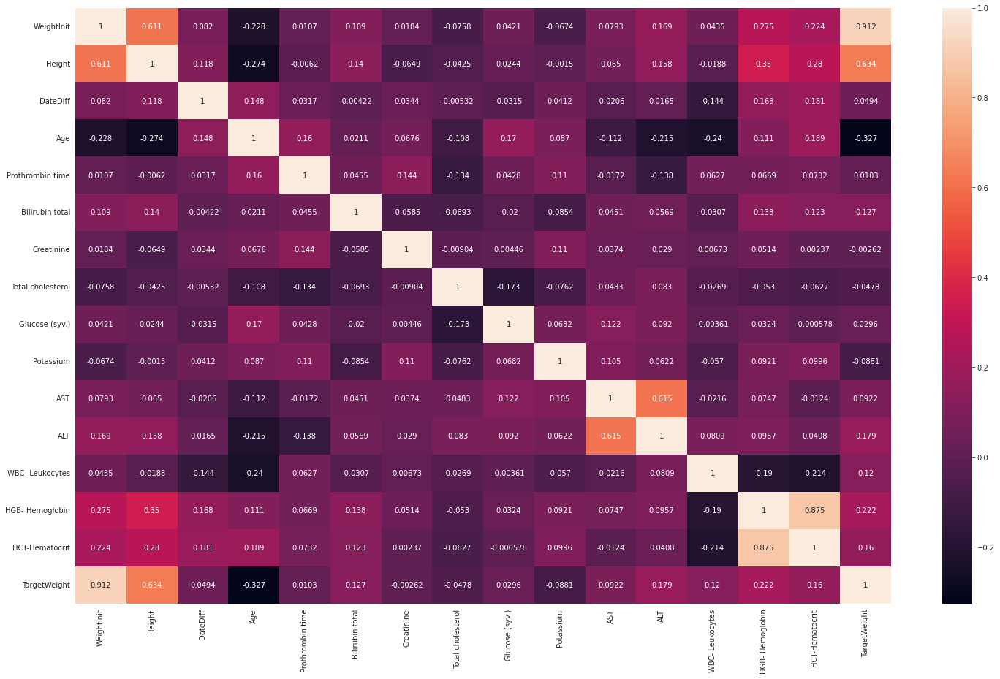

In [65]:
pearson = data[NUMERICAL].corr()

plt.figure(figsize=(25, 15))
sns.heatmap(pearson, annot=True, fmt='.3g')
plt.show()

In [66]:
data.to_csv("dataset_for_models.csv")